In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/human-segmentation/ICCV15_fashion_dataset(ATR)/humanparsing/SegmentationClassAug/dataset10k_9984.png
/kaggle/input/human-segmentation/ICCV15_fashion_dataset(ATR)/humanparsing/SegmentationClassAug/dataset10k_1242.png
/kaggle/input/human-segmentation/ICCV15_fashion_dataset(ATR)/humanparsing/SegmentationClassAug/Multi_41.png
/kaggle/input/human-segmentation/ICCV15_fashion_dataset(ATR)/humanparsing/SegmentationClassAug/2500_1769.png
/kaggle/input/human-segmentation/ICCV15_fashion_dataset(ATR)/humanparsing/SegmentationClassAug/dataset10k_9367.png
/kaggle/input/human-segmentation/ICCV15_fashion_dataset(ATR)/humanparsing/SegmentationClassAug/4565_714.png
/kaggle/input/human-segmentation/ICCV15_fashion_dataset(ATR)/humanparsing/SegmentationClassAug/997_753.png
/kaggle/input/human-segmentation/ICCV15_fashion_dataset(ATR)/humanparsing/SegmentationClassAug/dataset10k_9574.png
/kaggle/input/human-segmentation/ICCV15_fashion_dataset(ATR)/humanparsing/SegmentationClassAug/dataset10k_96

In [2]:
!git clone https://github.com/VikramShenoy97/Human-Segmentation-Dataset

Cloning into 'Human-Segmentation-Dataset'...
remote: Enumerating objects: 596, done.
remote: Total 596 (delta 0), reused 0 (delta 0), pack-reused 596
Receiving objects: 100% (596/596), 13.60 MiB | 42.72 MiB/s, done.
Resolving deltas: 100% (7/7), done.


In [3]:
training_image_path = "/kaggle/working/Human-Segmentation-Dataset/Training_Images"
annotation_path = "/kaggle/working/Human-Segmentation-Dataset/Ground_Truth"  # Update if necessary

In [4]:
import numpy as np
import pandas as pd 
import os
import cv2
import matplotlib.pyplot as plt
import math
import tensorflow as tf

2024-06-21 13:07:49.089101: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-21 13:07:49.089235: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-21 13:07:49.222968: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [5]:
import torchvision
from tqdm.notebook import tqdm
import torch.optim as optim

In [6]:
def show_images(folder_path, num_images=0, cols=4, rows=None):
    images = []
    for filename in os.listdir(folder_path):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            image_path = os.path.join(folder_path, filename)
            image = plt.imread(image_path)
            images.append(image)
            if num_images > 0 and len(images) >= num_images:
                break

  # Calculate rows if not provided
    if rows is None:
        rows = int(math.ceil(len(images) / cols))

  # Create a figure and subplots
    fig, axes = plt.subplots(rows, cols, figsize=(12, rows * 3))  # Adjust figsize as needed

  # Display images on subplots
    for i in range(len(images)):
        axes.flat[i].imshow(images[i])
        axes.flat[i].axis('off')  # Hide axes

  # Adjust layout
    fig.tight_layout()
    plt.show()

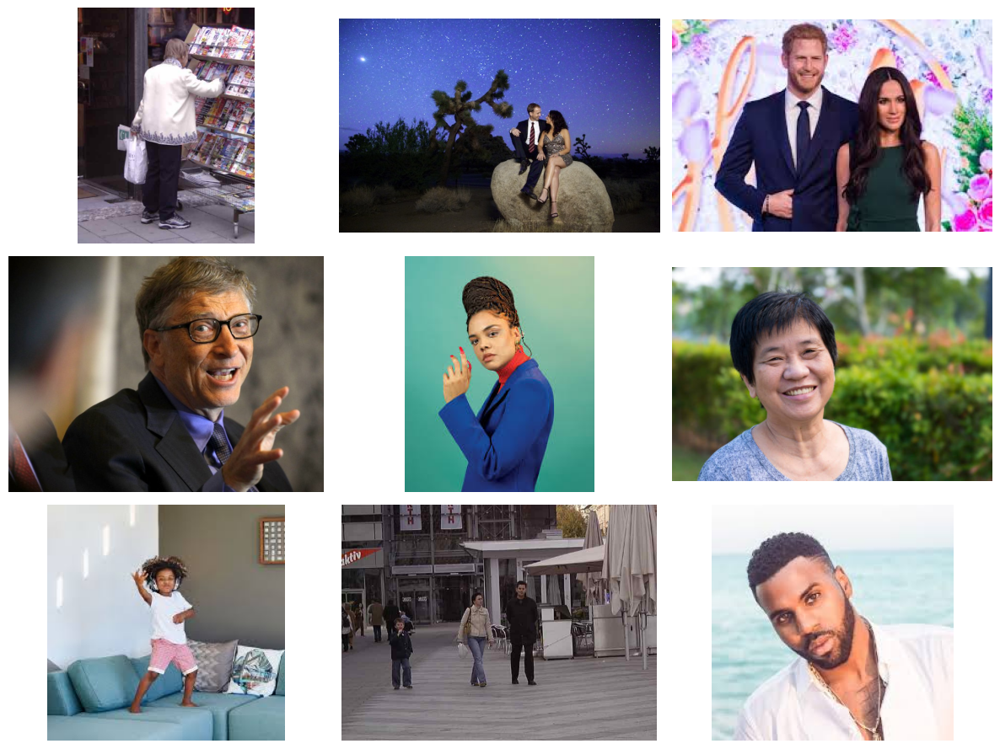

In [7]:
folder_path = "/kaggle/working/Human-Segmentation-Dataset/Training_Images"
show_images(folder_path, num_images=9, cols=3)

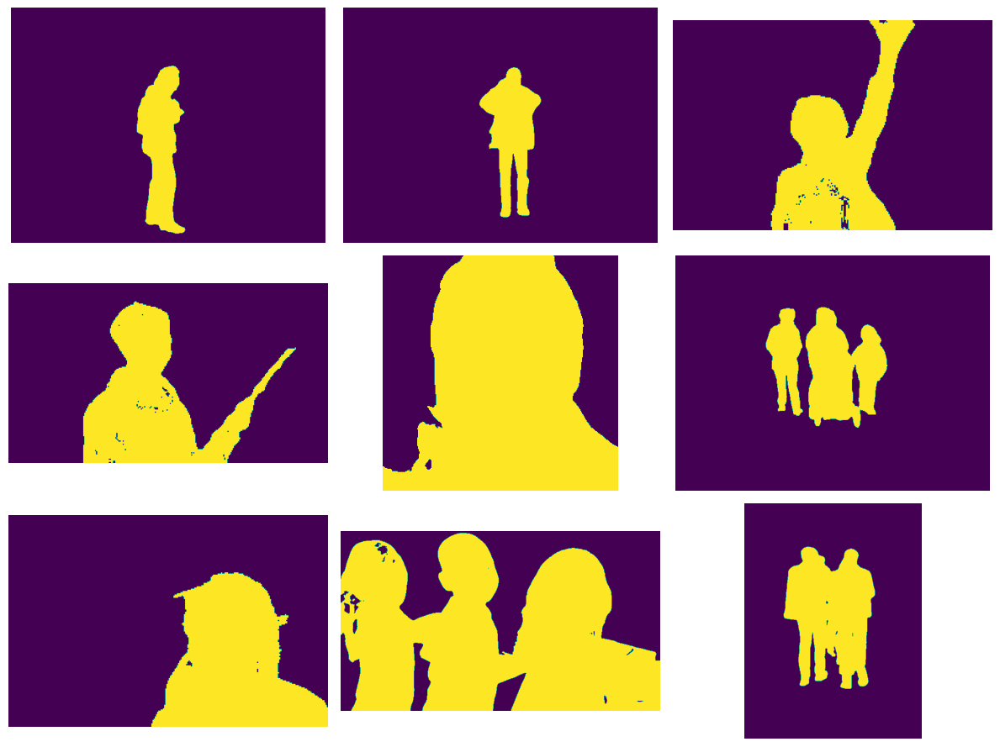

In [8]:
folder_path = "/kaggle/working/Human-Segmentation-Dataset/Ground_Truth"
show_images(folder_path, num_images=9, cols=3)

In [9]:
import torch
from torch.utils.data import Dataset, DataLoader

In [10]:
device = "cuda:0"

In [11]:
!pip install -q tfds-nightly
!tfds --version

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


TensorFlow Datasets: 4.9.6+nightly


In [12]:
!cd /kaggle/working/Human-Segmentation-Dataset
!tfds new Human_Segmentation

Dataset generated at /kaggle/working/human_segmentation
You can start searching `TODO(human_segmentation)` to complete the implementation.
Please check https://www.tensorflow.org/datasets/add_dataset for additional details.


In [13]:
import os
os.getcwd()

'/kaggle/working'